In [1]:
import os
import numpy as np

import matplotlib.pyplot as plt
import matplotlib.patches as patches

import torch
import torchvision
from torchvision.utils import make_grid
from torchvision.io import read_image
from torchvision import datasets, transforms
import torchvision.transforms.functional as F
import matplotlib.image as mpimg

import os

import requests
from PIL import Image
from tqdm import tqdm as tqdm

from super_gradients.training import Trainer, dataloaders, models
from super_gradients.training.dataloaders.dataloaders import (
    coco_detection_yolo_format_train, coco_detection_yolo_format_val
)
from super_gradients.training.utils.distributed_training_utils import setup_device
from super_gradients.training.losses import PPYoloELoss
from super_gradients.training.metrics import DetectionMetrics_050
from super_gradients.training.models.detection_models.pp_yolo_e import (
    PPYoloEPostPredictionCallback
)


/home/alcose/anaconda3/envs/yolo/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
[2023-05-22 15:36:20] INFO - crash_tips_setup.py - Crash tips is enabled. You can set your environment variable to CRASH_HANDLER=FALSE to disable it


The console stream is logged into /home/alcose/sg_logs/console.log


[2023-05-22 15:36:20] WARNING - __init__.py - Failed to import pytorch_quantization
[2023-05-22 15:36:20] WARNING - calibrator.py - Failed to import pytorch_quantization
[2023-05-22 15:36:20] WARNING - export.py - Failed to import pytorch_quantization
[2023-05-22 15:36:20] WARNING - selective_quantization_utils.py - Failed to import pytorch_quantization


In [2]:
def plot_bboxes(image, boxes, normalized = True):
    
    # Create figure and axes
    fig, ax = plt.subplots()
    # Display the image
    ax.imshow(image)
        
    #plot each boxes
    for box in boxes:
        lw = max(round(sum(image.shape) / 2 * 0.003), 2)
        #cxy = (int(box[0]*xpix), int(box[1]*ypix))
        if normalized:
            xpix, ypix, chan = image.shape
            width, height = (int(box[2]*xpix), int(box[3]*ypix))
            xy = (int(box[0]*xpix - 0.5*width), int(box[1]*ypix - 0.5*height))
        else:
            width, height = (box[2], box[3])
            xy = (box[0]- 0.5*width, box[1] - 0.5*height)
        # Create a Rectangle patch
        rect = patches.Rectangle(xy, width, height, linewidth=lw, edgecolor='g', facecolor='none')
        # Add the patch to the Axes
        ax.add_patch(rect)
    #show image
    plt.show()

In [3]:
class config:
    #trainer params
    CHECKPOINT_DIR = './results' #specify the path you want to save checkpoints to
    EXPERIMENT_NAME = 'test' #specify the experiment name

    #dataset params
    DATA_DIR = '../data/mars_rover' #parent directory to where data lives

    TRAIN_IMAGES_DIR = 'train/images' #child dir of DATA_DIR where train images are
    TRAIN_LABELS_DIR = 'train/labels' #child dir of DATA_DIR where train labels are

    VAL_IMAGES_DIR = 'valid/images' #child dir of DATA_DIR where validation images are
    VAL_LABELS_DIR = 'valid/labels' #child dir of DATA_DIR where validation labels are

    # if you have a test set
    TEST_IMAGES_DIR = 'test/images' #child dir of DATA_DIR where test images are
    TEST_LABELS_DIR = 'test/labels' #child dir of DATA_DIR where test labels are

    CLASSES = ['rock', 'rover'] #what class names do you have

    NUM_CLASSES = len(CLASSES)

    #dataloader params - you can add whatever PyTorch dataloader params you have
    #could be different across train, val, and test
    DATALOADER_PARAMS={
    'batch_size':4,
    'num_workers':2
    }

    # model params
    MODEL_NAME = 'yolo_nas_l' # choose from yolo_nas_s, yolo_nas_m, yolo_nas_l
    PRETRAINED_WEIGHTS = 'coco' #only one option here: coco
    

In [4]:
train_data = coco_detection_yolo_format_train(
    dataset_params={
        'data_dir': config.DATA_DIR,
        'images_dir': config.TRAIN_IMAGES_DIR,
        'labels_dir': config.TRAIN_LABELS_DIR,
        'classes': config.CLASSES
    },
    dataloader_params=config.DATALOADER_PARAMS
)

val_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': config.DATA_DIR,
        'images_dir': config.VAL_IMAGES_DIR,
        'labels_dir': config.VAL_LABELS_DIR,
        'classes': config.CLASSES
    },
    dataloader_params=config.DATALOADER_PARAMS
)

test_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': config.DATA_DIR,
        'images_dir': config.TEST_IMAGES_DIR,
        'labels_dir': config.TEST_LABELS_DIR,
        'classes': config.CLASSES
    },
    dataloader_params=config.DATALOADER_PARAMS
)

Caching annotations: 100%|██████████████████| 396/396 [00:00<00:00, 3844.04it/s]
[2023-05-22 15:36:21] WARNING - detection_dataset.py - Found 45 invalid bbox that were ignored. For more information, please set `show_all_warnings=True`.
Caching annotations: 100%|████████████████████| 88/88 [00:00<00:00, 4114.49it/s]
[2023-05-22 15:36:21] WARNING - detection_dataset.py - Found 15 invalid bbox that were ignored. For more information, please set `show_all_warnings=True`.
Caching annotations: 100%|██████████████████| 102/102 [00:00<00:00, 4290.98it/s]
[2023-05-22 15:36:21] WARNING - detection_dataset.py - Found 10 invalid bbox that were ignored. For more information, please set `show_all_warnings=True`.


In [5]:
train_params = {
    # ENABLING SILENT MODE
    "average_best_models":True,
    "warmup_mode": "linear_epoch_step",
    "warmup_initial_lr": 1e-6,
    "lr_warmup_epochs": 3,
    "initial_lr": 5e-4,
    "lr_mode": "cosine",
    "cosine_final_lr_ratio": 0.1,
    "optimizer": "Adam",
    "optimizer_params": {"weight_decay": 0.0001},
    "zero_weight_decay_on_bias_and_bn": True,
    "ema": True,
    "ema_params": {"decay": 0.9, "decay_type": "threshold"},
    # ONLY TRAINING FOR 10 EPOCHS FOR THIS EXAMPLE NOTEBOOK
    "max_epochs": 10,
    "mixed_precision": True,
    "loss": PPYoloELoss(
        use_static_assigner=False,
        # NOTE: num_classes needs to be defined here
        num_classes=config.NUM_CLASSES,
        reg_max=16
    ),
    "valid_metrics_list": [
        DetectionMetrics_050(
            score_thres=0.1,
            top_k_predictions=300,
            # NOTE: num_classes needs to be defined here
            num_cls=config.NUM_CLASSES,
            normalize_targets=True,
            post_prediction_callback=PPYoloEPostPredictionCallback(
                score_threshold=0.01,
                nms_top_k=1000,
                max_predictions=300,
                nms_threshold=0.7
            )
        )
    ],
    "metric_to_watch": 'mAP@0.50'
}

device = 'cuda' if torch.cuda.is_available() else "cpu"

In [6]:
# Launch DDP on 4 GPUs'
setup_device(num_gpus=1) # Equivalent to: setup_device(multi_gpu='DDP', num_gpus=2)

trainer = Trainer(experiment_name=config.EXPERIMENT_NAME, ckpt_root_dir=config.CHECKPOINT_DIR)
model = models.get(config.MODEL_NAME, 
                   num_classes=config.NUM_CLASSES, 
                   pretrained_weights=config.PRETRAINED_WEIGHTS
                   )
trainer.train(model=model, 
              training_params=train_params, 
              train_loader=train_data, 
              valid_loader=val_data)

[2023-05-22 15:36:21] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.
[2023-05-22 15:36:22] INFO - sg_trainer.py - Using EMA with params {'decay': 0.9, 'decay_type': 'threshold'}


The console stream is now moved to ./results/test/console_May22_15_36_22.txt


[2023-05-22 15:36:22] INFO - sg_trainer_utils.py - TRAINING PARAMETERS:
    - Mode:                         OFF
    - Number of GPUs:               1          (2 available on the machine)
    - Dataset size:                 385        (len(train_set))
    - Batch size per GPU:           4          (batch_size)
    - Batch Accumulate:             1          (batch_accumulate)
    - Total batch size:             4          (num_gpus * batch_size)
    - Effective Batch size:         4          (num_gpus * batch_size * batch_accumulate)
    - Iterations per epoch:         96         (len(train_loader))
    - Gradient updates per epoch:   96         (len(train_loader) / batch_accumulate)

[2023-05-22 15:36:22] INFO - sg_trainer.py - Started training for 10 epochs (0/9)

Train epoch 0: 100%|██████████| 96/96 [00:23<00:00,  4.02it/s, PPYoloELoss/loss=
Validation epoch 0: 100%|██████████| 21/21 [00:02<00:00,  8.55it/s]


SUMMARY OF EPOCH 0
├── Training
│   ├── Ppyoloeloss/loss = 3.6866
│   ├── Ppyoloeloss/loss_cls = 2.1249
│   ├── Ppyoloeloss/loss_dfl = 1.3759
│   └── Ppyoloeloss/loss_iou = 0.3495
└── Validation
    ├── F1@0.50 = 0.0
    ├── Map@0.50 = 0.0016
    ├── Ppyoloeloss/loss = 3.6462
    ├── Ppyoloeloss/loss_cls = 2.3124
    ├── Ppyoloeloss/loss_dfl = 1.1683
    ├── Ppyoloeloss/loss_iou = 0.2998
    ├── Precision@0.50 = 0.0
    └── Recall@0.50 = 0.0



[2023-05-22 15:36:49] INFO - base_sg_logger.py - Checkpoint saved in ./results/test/ckpt_best.pth
[2023-05-22 15:36:49] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.0015665905084460974
Train epoch 1: 100%|██████████| 96/96 [00:23<00:00,  4.13it/s, PPYoloELoss/loss=
Validation epoch 1: 100%|██████████| 21/21 [00:02<00:00,  8.03it/s]


SUMMARY OF EPOCH 1
├── Training
│   ├── Ppyoloeloss/loss = 2.4112
│   │   ├── Best until now = 3.6866 (↘ -1.2753)
│   │   └── Epoch N-1      = 3.6866 (↘ -1.2753)
│   ├── Ppyoloeloss/loss_cls = 1.1175
│   │   ├── Best until now = 2.1249 (↘ -1.0075)
│   │   └── Epoch N-1      = 2.1249 (↘ -1.0075)
│   ├── Ppyoloeloss/loss_dfl = 1.1534
│   │   ├── Best until now = 1.3759 (↘ -0.2225)
│   │   └── Epoch N-1      = 1.3759 (↘ -0.2225)
│   └── Ppyoloeloss/loss_iou = 0.2868
│       ├── Best until now = 0.3495 (↘ -0.0627)
│       └── Epoch N-1      = 0.3495 (↘ -0.0627)
└── Validation
    ├── F1@0.50 = 0.0907
    │   ├── Best until now = 0.0    (↗ 0.0907)
    │   └── Epoch N-1      = 0.0    (↗ 0.0907)
    ├── Map@0.50 = 0.4277
    │   ├── Best until now = 0.0016 (↗ 0.4261)
    │   └── Epoch N-1      = 0.0016 (↗ 0.4261)
    ├── Ppyoloeloss/loss = 2.4246
    │   ├── Best until now = 3.6462 (↘ -1.2216)
    │   └── Epoch N-1      = 3.6462 (↘ -1.2216)
    ├── Ppyoloeloss/loss_cls = 1.2211
    │   ├── Be

[2023-05-22 15:37:18] INFO - base_sg_logger.py - Checkpoint saved in ./results/test/ckpt_best.pth
[2023-05-22 15:37:18] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.4277082681655884
Train epoch 2: 100%|██████████| 96/96 [00:23<00:00,  4.12it/s, PPYoloELoss/loss=
Validation epoch 2: 100%|██████████| 21/21 [00:02<00:00,  8.03it/s]


SUMMARY OF EPOCH 2
├── Training
│   ├── Ppyoloeloss/loss = 2.2886
│   │   ├── Best until now = 2.4112 (↘ -0.1227)
│   │   └── Epoch N-1      = 2.4112 (↘ -0.1227)
│   ├── Ppyoloeloss/loss_cls = 1.0444
│   │   ├── Best until now = 1.1175 (↘ -0.0731)
│   │   └── Epoch N-1      = 1.1175 (↘ -0.0731)
│   ├── Ppyoloeloss/loss_dfl = 1.0914
│   │   ├── Best until now = 1.1534 (↘ -0.062)
│   │   └── Epoch N-1      = 1.1534 (↘ -0.062)
│   └── Ppyoloeloss/loss_iou = 0.2794
│       ├── Best until now = 0.2868 (↘ -0.0074)
│       └── Epoch N-1      = 0.2868 (↘ -0.0074)
└── Validation
    ├── F1@0.50 = 0.0918
    │   ├── Best until now = 0.0907 (↗ 0.0011)
    │   └── Epoch N-1      = 0.0907 (↗ 0.0011)
    ├── Map@0.50 = 0.4876
    │   ├── Best until now = 0.4277 (↗ 0.0598)
    │   └── Epoch N-1      = 0.4277 (↗ 0.0598)
    ├── Ppyoloeloss/loss = 2.3422
    │   ├── Best until now = 2.4246 (↘ -0.0824)
    │   └── Epoch N-1      = 2.4246 (↘ -0.0824)
    ├── Ppyoloeloss/loss_cls = 1.1586
    │   ├── Best

[2023-05-22 15:37:46] INFO - base_sg_logger.py - Checkpoint saved in ./results/test/ckpt_best.pth
[2023-05-22 15:37:46] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.48755767941474915
Train epoch 3: 100%|██████████| 96/96 [00:23<00:00,  4.10it/s, PPYoloELoss/loss=
Validation epoch 3: 100%|██████████| 21/21 [00:02<00:00,  7.95it/s]


SUMMARY OF EPOCH 3
├── Training
│   ├── Ppyoloeloss/loss = 2.2662
│   │   ├── Best until now = 2.2886 (↘ -0.0224)
│   │   └── Epoch N-1      = 2.2886 (↘ -0.0224)
│   ├── Ppyoloeloss/loss_cls = 1.0264
│   │   ├── Best until now = 1.0444 (↘ -0.0179)
│   │   └── Epoch N-1      = 1.0444 (↘ -0.0179)
│   ├── Ppyoloeloss/loss_dfl = 1.1118
│   │   ├── Best until now = 1.0914 (↗ 0.0204)
│   │   └── Epoch N-1      = 1.0914 (↗ 0.0204)
│   └── Ppyoloeloss/loss_iou = 0.2735
│       ├── Best until now = 0.2794 (↘ -0.0059)
│       └── Epoch N-1      = 0.2794 (↘ -0.0059)
└── Validation
    ├── F1@0.50 = 0.0917
    │   ├── Best until now = 0.0918 (↘ -0.0001)
    │   └── Epoch N-1      = 0.0918 (↘ -0.0001)
    ├── Map@0.50 = 0.52
    │   ├── Best until now = 0.4876 (↗ 0.0324)
    │   └── Epoch N-1      = 0.4876 (↗ 0.0324)
    ├── Ppyoloeloss/loss = 2.208
    │   ├── Best until now = 2.3422 (↘ -0.1342)
    │   └── Epoch N-1      = 2.3422 (↘ -0.1342)
    ├── Ppyoloeloss/loss_cls = 1.006
    │   ├── Best u

[2023-05-22 15:38:15] INFO - base_sg_logger.py - Checkpoint saved in ./results/test/ckpt_best.pth
[2023-05-22 15:38:15] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.5199694633483887
Train epoch 4: 100%|██████████| 96/96 [00:23<00:00,  4.11it/s, PPYoloELoss/loss=
Validation epoch 4: 100%|██████████| 21/21 [00:02<00:00,  7.96it/s]


SUMMARY OF EPOCH 4
├── Training
│   ├── Ppyoloeloss/loss = 2.2177
│   │   ├── Best until now = 2.2662 (↘ -0.0485)
│   │   └── Epoch N-1      = 2.2662 (↘ -0.0485)
│   ├── Ppyoloeloss/loss_cls = 1.0096
│   │   ├── Best until now = 1.0264 (↘ -0.0168)
│   │   └── Epoch N-1      = 1.0264 (↘ -0.0168)
│   ├── Ppyoloeloss/loss_dfl = 1.0668
│   │   ├── Best until now = 1.0914 (↘ -0.0246)
│   │   └── Epoch N-1      = 1.1118 (↘ -0.045)
│   └── Ppyoloeloss/loss_iou = 0.2699
│       ├── Best until now = 0.2735 (↘ -0.0037)
│       └── Epoch N-1      = 0.2735 (↘ -0.0037)
└── Validation
    ├── F1@0.50 = 0.0922
    │   ├── Best until now = 0.0918 (↗ 0.0005)
    │   └── Epoch N-1      = 0.0917 (↗ 0.0005)
    ├── Map@0.50 = 0.5365
    │   ├── Best until now = 0.52   (↗ 0.0165)
    │   └── Epoch N-1      = 0.52   (↗ 0.0165)
    ├── Ppyoloeloss/loss = 2.1871
    │   ├── Best until now = 2.208  (↘ -0.0208)
    │   └── Epoch N-1      = 2.208  (↘ -0.0208)
    ├── Ppyoloeloss/loss_cls = 1.0273
    │   ├── Bes

[2023-05-22 15:38:45] INFO - base_sg_logger.py - Checkpoint saved in ./results/test/ckpt_best.pth
[2023-05-22 15:38:45] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.536503791809082
Train epoch 5: 100%|██████████| 96/96 [00:23<00:00,  4.10it/s, PPYoloELoss/loss=
Validation epoch 5: 100%|██████████| 21/21 [00:02<00:00,  7.94it/s]


SUMMARY OF EPOCH 5
├── Training
│   ├── Ppyoloeloss/loss = 2.167
│   │   ├── Best until now = 2.2177 (↘ -0.0507)
│   │   └── Epoch N-1      = 2.2177 (↘ -0.0507)
│   ├── Ppyoloeloss/loss_cls = 0.9958
│   │   ├── Best until now = 1.0096 (↘ -0.0139)
│   │   └── Epoch N-1      = 1.0096 (↘ -0.0139)
│   ├── Ppyoloeloss/loss_dfl = 1.0363
│   │   ├── Best until now = 1.0668 (↘ -0.0305)
│   │   └── Epoch N-1      = 1.0668 (↘ -0.0305)
│   └── Ppyoloeloss/loss_iou = 0.2612
│       ├── Best until now = 0.2699 (↘ -0.0086)
│       └── Epoch N-1      = 0.2699 (↘ -0.0086)
└── Validation
    ├── F1@0.50 = 0.1018
    │   ├── Best until now = 0.0922 (↗ 0.0096)
    │   └── Epoch N-1      = 0.0922 (↗ 0.0096)
    ├── Map@0.50 = 0.576
    │   ├── Best until now = 0.5365 (↗ 0.0395)
    │   └── Epoch N-1      = 0.5365 (↗ 0.0395)
    ├── Ppyoloeloss/loss = 2.1308
    │   ├── Best until now = 2.1871 (↘ -0.0563)
    │   └── Epoch N-1      = 2.1871 (↘ -0.0563)
    ├── Ppyoloeloss/loss_cls = 0.9758
    │   ├── Best

[2023-05-22 15:39:14] INFO - base_sg_logger.py - Checkpoint saved in ./results/test/ckpt_best.pth
[2023-05-22 15:39:14] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.5760100483894348
Train epoch 6: 100%|██████████| 96/96 [00:23<00:00,  4.11it/s, PPYoloELoss/loss=
Validation epoch 6: 100%|██████████| 21/21 [00:02<00:00,  7.94it/s]


SUMMARY OF EPOCH 6
├── Training
│   ├── Ppyoloeloss/loss = 2.1636
│   │   ├── Best until now = 2.167  (↘ -0.0035)
│   │   └── Epoch N-1      = 2.167  (↘ -0.0035)
│   ├── Ppyoloeloss/loss_cls = 1.0018
│   │   ├── Best until now = 0.9958 (↗ 0.006)
│   │   └── Epoch N-1      = 0.9958 (↗ 0.006)
│   ├── Ppyoloeloss/loss_dfl = 1.018
│   │   ├── Best until now = 1.0363 (↘ -0.0183)
│   │   └── Epoch N-1      = 1.0363 (↘ -0.0183)
│   └── Ppyoloeloss/loss_iou = 0.2611
│       ├── Best until now = 0.2612 (↘ -1e-04)
│       └── Epoch N-1      = 0.2612 (↘ -1e-04)
└── Validation
    ├── F1@0.50 = 0.0971
    │   ├── Best until now = 0.1018 (↘ -0.0047)
    │   └── Epoch N-1      = 0.1018 (↘ -0.0047)
    ├── Map@0.50 = 0.5977
    │   ├── Best until now = 0.576  (↗ 0.0217)
    │   └── Epoch N-1      = 0.576  (↗ 0.0217)
    ├── Ppyoloeloss/loss = 2.1467
    │   ├── Best until now = 2.1308 (↗ 0.0158)
    │   └── Epoch N-1      = 2.1308 (↗ 0.0158)
    ├── Ppyoloeloss/loss_cls = 1.0229
    │   ├── Best unti

[2023-05-22 15:39:44] INFO - base_sg_logger.py - Checkpoint saved in ./results/test/ckpt_best.pth
[2023-05-22 15:39:44] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.5976991653442383
Train epoch 7: 100%|██████████| 96/96 [00:23<00:00,  4.12it/s, PPYoloELoss/loss=
Validation epoch 7: 100%|██████████| 21/21 [00:02<00:00,  7.96it/s]


SUMMARY OF EPOCH 7
├── Training
│   ├── Ppyoloeloss/loss = 2.1348
│   │   ├── Best until now = 2.1636 (↘ -0.0287)
│   │   └── Epoch N-1      = 2.1636 (↘ -0.0287)
│   ├── Ppyoloeloss/loss_cls = 0.992
│   │   ├── Best until now = 0.9958 (↘ -0.0038)
│   │   └── Epoch N-1      = 1.0018 (↘ -0.0098)
│   ├── Ppyoloeloss/loss_dfl = 1.0078
│   │   ├── Best until now = 1.018  (↘ -0.0102)
│   │   └── Epoch N-1      = 1.018  (↘ -0.0102)
│   └── Ppyoloeloss/loss_iou = 0.2556
│       ├── Best until now = 0.2611 (↘ -0.0055)
│       └── Epoch N-1      = 0.2611 (↘ -0.0055)
└── Validation
    ├── F1@0.50 = 0.1039
    │   ├── Best until now = 0.1018 (↗ 0.0021)
    │   └── Epoch N-1      = 0.0971 (↗ 0.0067)
    ├── Map@0.50 = 0.6186
    │   ├── Best until now = 0.5977 (↗ 0.0209)
    │   └── Epoch N-1      = 0.5977 (↗ 0.0209)
    ├── Ppyoloeloss/loss = 2.0828
    │   ├── Best until now = 2.1308 (↘ -0.048)
    │   └── Epoch N-1      = 2.1467 (↘ -0.0639)
    ├── Ppyoloeloss/loss_cls = 0.9799
    │   ├── Best

[2023-05-22 15:40:14] INFO - base_sg_logger.py - Checkpoint saved in ./results/test/ckpt_best.pth
[2023-05-22 15:40:14] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.6185714602470398
Train epoch 8: 100%|██████████| 96/96 [00:23<00:00,  4.12it/s, PPYoloELoss/loss=
Validation epoch 8: 100%|██████████| 21/21 [00:02<00:00,  7.97it/s]


SUMMARY OF EPOCH 8
├── Training
│   ├── Ppyoloeloss/loss = 2.105
│   │   ├── Best until now = 2.1348 (↘ -0.0298)
│   │   └── Epoch N-1      = 2.1348 (↘ -0.0298)
│   ├── Ppyoloeloss/loss_cls = 0.9785
│   │   ├── Best until now = 0.992  (↘ -0.0135)
│   │   └── Epoch N-1      = 0.992  (↘ -0.0135)
│   ├── Ppyoloeloss/loss_dfl = 0.9951
│   │   ├── Best until now = 1.0078 (↘ -0.0127)
│   │   └── Epoch N-1      = 1.0078 (↘ -0.0127)
│   └── Ppyoloeloss/loss_iou = 0.2516
│       ├── Best until now = 0.2556 (↘ -0.004)
│       └── Epoch N-1      = 0.2556 (↘ -0.004)
└── Validation
    ├── F1@0.50 = 0.1037
    │   ├── Best until now = 0.1039 (↘ -0.0002)
    │   └── Epoch N-1      = 0.1039 (↘ -0.0002)
    ├── Map@0.50 = 0.6107
    │   ├── Best until now = 0.6186 (↘ -0.0079)
    │   └── Epoch N-1      = 0.6186 (↘ -0.0079)
    ├── Ppyoloeloss/loss = 2.1144
    │   ├── Best until now = 2.0828 (↗ 0.0316)
    │   └── Epoch N-1      = 2.0828 (↗ 0.0316)
    ├── Ppyoloeloss/loss_cls = 1.0102
    │   ├── Bes

Train epoch 9: 100%|██████████| 96/96 [00:23<00:00,  4.13it/s, PPYoloELoss/loss=
Validation epoch 9: 100%|██████████| 21/21 [00:02<00:00,  8.02it/s]


SUMMARY OF EPOCH 9
├── Training
│   ├── Ppyoloeloss/loss = 2.0867
│   │   ├── Best until now = 2.105  (↘ -0.0183)
│   │   └── Epoch N-1      = 2.105  (↘ -0.0183)
│   ├── Ppyoloeloss/loss_cls = 0.9785
│   │   ├── Best until now = 0.9785 (↘ -0.0)
│   │   └── Epoch N-1      = 0.9785 (↘ -0.0)
│   ├── Ppyoloeloss/loss_dfl = 0.9785
│   │   ├── Best until now = 0.9951 (↘ -0.0166)
│   │   └── Epoch N-1      = 0.9951 (↘ -0.0166)
│   └── Ppyoloeloss/loss_iou = 0.2476
│       ├── Best until now = 0.2516 (↘ -0.004)
│       └── Epoch N-1      = 0.2516 (↘ -0.004)
└── Validation
    ├── F1@0.50 = 0.1028
    │   ├── Best until now = 0.1039 (↘ -0.0011)
    │   └── Epoch N-1      = 0.1037 (↘ -0.0009)
    ├── Map@0.50 = 0.6232
    │   ├── Best until now = 0.6186 (↗ 0.0047)
    │   └── Epoch N-1      = 0.6107 (↗ 0.0126)
    ├── Ppyoloeloss/loss = 2.0638
    │   ├── Best until now = 2.0828 (↘ -0.0189)
    │   └── Epoch N-1      = 2.1144 (↘ -0.0506)
    ├── Ppyoloeloss/loss_cls = 0.9679
    │   ├── Best unt

[2023-05-22 15:41:14] INFO - base_sg_logger.py - Checkpoint saved in ./results/test/ckpt_best.pth
[2023-05-22 15:41:14] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.6232267618179321
[2023-05-22 15:41:18] INFO - sg_trainer.py - RUNNING ADDITIONAL TEST ON THE AVERAGED MODEL...
Validation epoch 10:  95%|█████████▌| 20/21 [00:02<00:00,  8.38it/s]

Predicting Images: 100%|██████████████████████| 102/102 [00:02<00:00, 36.33it/s]


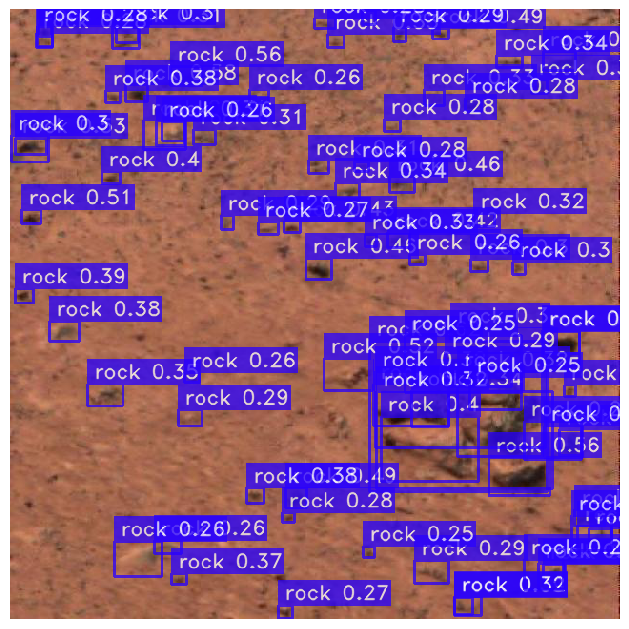

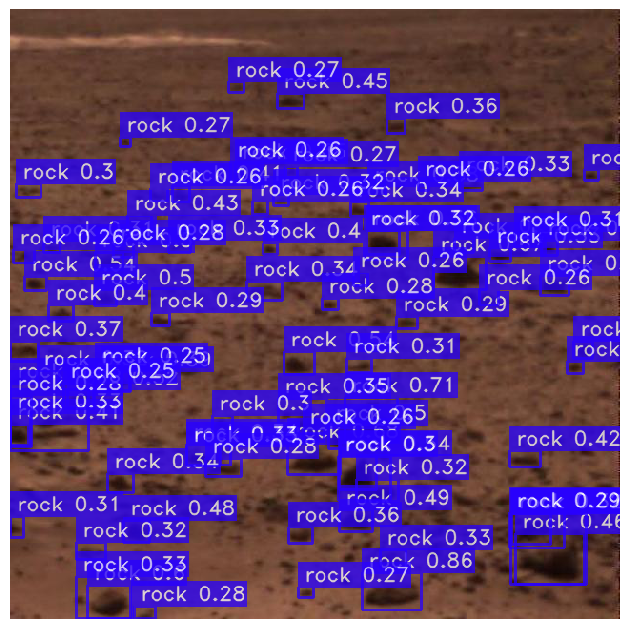

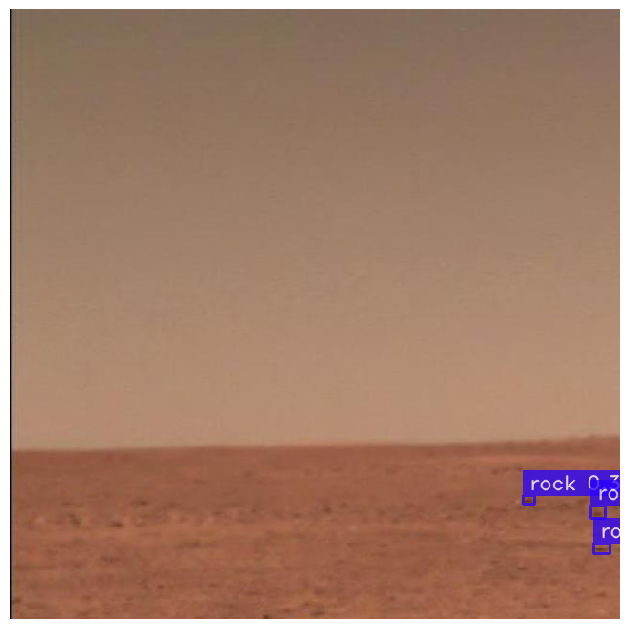

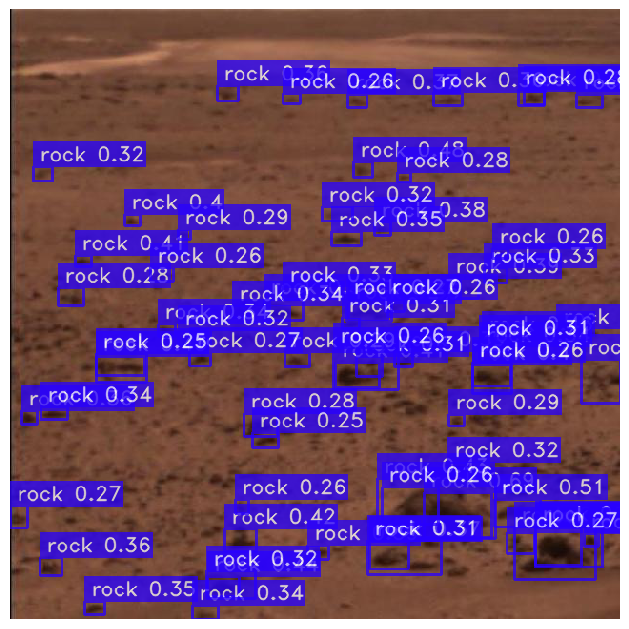

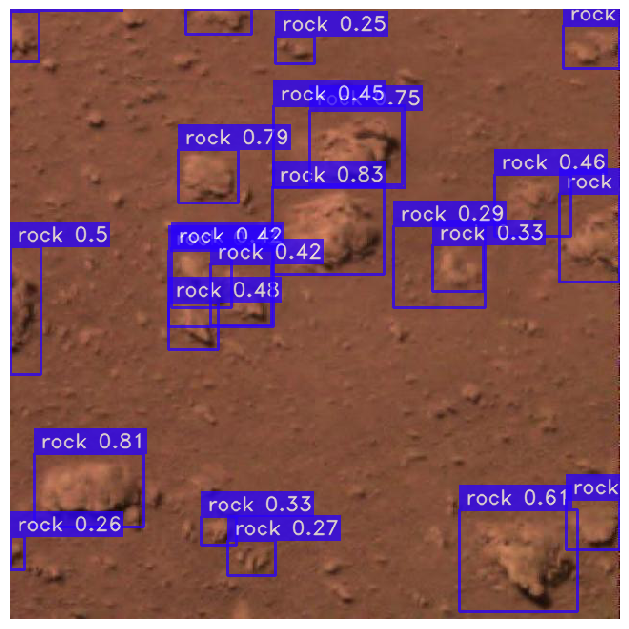

...

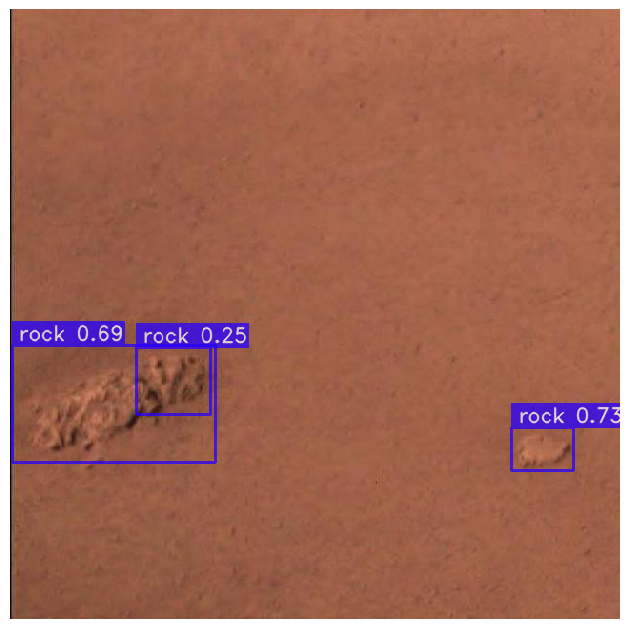

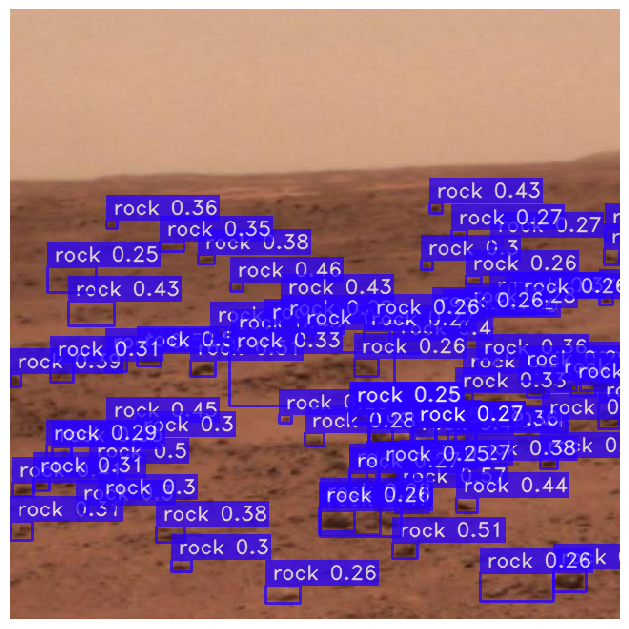

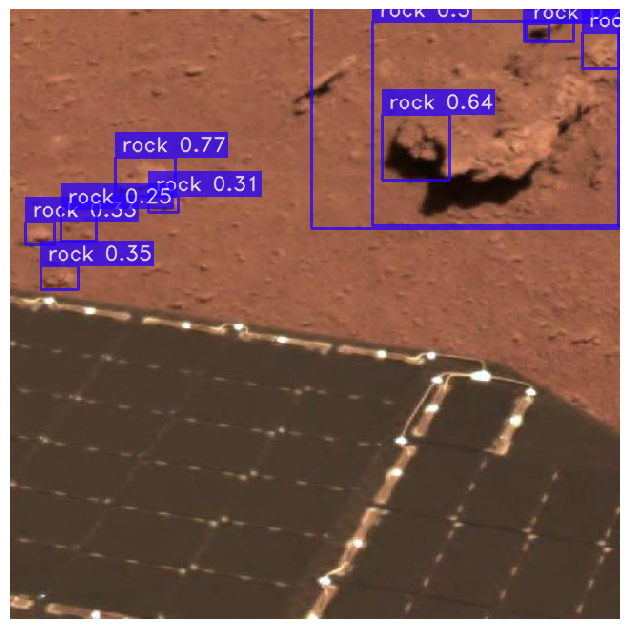

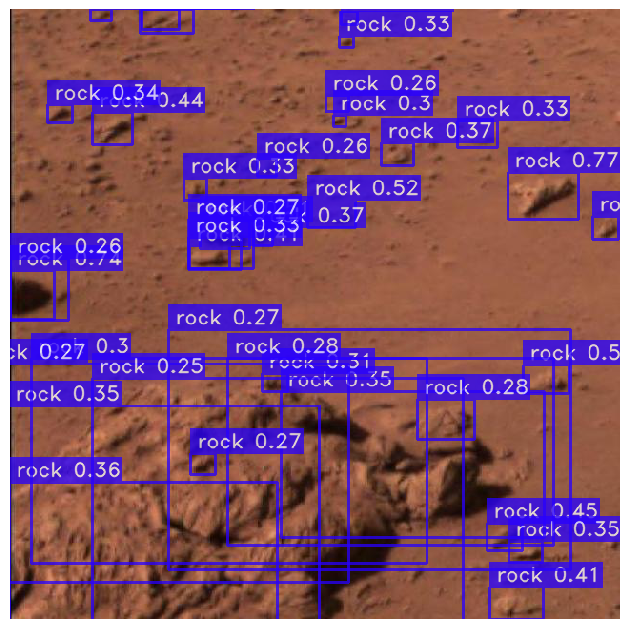

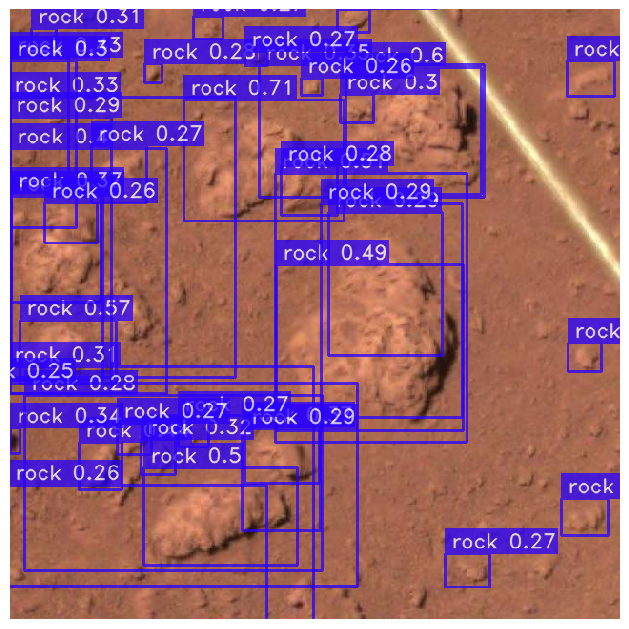

In [8]:
img_dir = '../data/mars_rover/test/images'
img_list = os.listdir(img_dir)
images = []
for img in img_list:
    images.append(mpimg.imread(os.path.join(img_dir,img)))
    
prediction = model.predict(images,conf=0.25)
prediction.show()